In [ ]:
!pip install kaggle

! mkdir ~/.kaggle

!touch kaggle.json

!echo '{"username":"akhilandroid","key":"3fa1d365cb1f94a2247a885bbb03585c"}' >> kaggle.json
!cp /content/kaggle.json ~/.kaggle/

!chmod 600 /root/.kaggle/kaggle.json


!mkdir -p /content/craft-pretrained-model
!!mkdir -p /content/personal-identification-image-dataset-for-india

!kaggle datasets download ajeetverma/craft-pretrained-model
!unzip /content/craft-pretrained-model.zip -d /content/craft-pretrained-model


!kaggle datasets download mehaksingal/personal-identification-image-dataset-for-india
!unzip /content/personal-identification-image-dataset-for-india.zip -d /content/personal-identification-image-dataset-for-india

Dataset URL: https://www.kaggle.com/datasets/ajeetverma/craft-pretrained-model
License(s): unknown
 67% 49.0M/73.7M [00:00<00:00, 157MB/s]
100% 73.7M/73.7M [00:00<00:00, 169MB/s]
Archive:  /content/craft-pretrained-model.zip
  inflating: /content/craft-pretrained-model/craft_ic15_20k.pth  
Dataset URL: https://www.kaggle.com/datasets/mehaksingal/personal-identification-image-dataset-for-india
License(s): DbCL-1.0
 86% 62.0M/72.4M [00:00<00:00, 91.0MB/s]
100% 72.4M/72.4M [00:00<00:00, 104MB/s] 
Archive:  /content/personal-identification-image-dataset-for-india.zip
  inflating: /content/personal-identification-image-dataset-for-india/Aadhaar/1.jpg  
  inflating: /content/personal-identification-image-dataset-for-india/Aadhaar/10.jpg  
  inflating: /content/personal-identification-image-dataset-for-india/Aadhaar/11.jpg  
  inflating: /content/personal-identification-image-dataset-for-india/Aadhaar/12.jpg  
  inflating: /content/personal-identification-image-dataset-for-india/Aadhaar/13.jp

In [ ]:
import os
import random
import shutil

# Specify the directory containing subfolders and the target directory
source_directory = '/content/personal-identification-image-dataset-for-india'
target_directory = '/content/tesing'

# Create the target directory if it does not exist
if not os.path.exists(target_directory):
    os.makedirs(target_directory)

# Counter for naming the images in the target directory
counter = 1

# Walk through the source directory and process each subfolder
for root, dirs, files in os.walk(source_directory):
    # Skip the source directory itself and process only subdirectories
    if root == source_directory:
        continue

    print(f"Processing subfolder: {root}")

    # Collect all jpg file paths in the current subfolder
    images_in_subfolder = [os.path.join(root, file) for file in files if file.endswith('.jpg')]

    print(f"Found {len(images_in_subfolder)} images in subfolder {root}")

    # If there are more than 5 images, select 5 at random
    if len(images_in_subfolder) > 5:
        selected_images = random.sample(images_in_subfolder, 5)
    else:
        selected_images = images_in_subfolder

    print(f"Selected images: {selected_images}")

    # Copy the selected images to the target directory with new names
    for image_path in selected_images:
        new_image_path = os.path.join(target_directory, f'test{counter}.jpg')
        shutil.copy(image_path, new_image_path)
        print(f"Copied {image_path} to {new_image_path}")
        counter += 1

print(f"Selected images have been copied to {target_directory}")

Processing subfolder: /content/personal-identification-image-dataset-for-india/Voter ID
Found 99 images in subfolder /content/personal-identification-image-dataset-for-india/Voter ID
Selected images: ['/content/personal-identification-image-dataset-for-india/Voter ID/77.jpg', '/content/personal-identification-image-dataset-for-india/Voter ID/28.jpg', '/content/personal-identification-image-dataset-for-india/Voter ID/37.jpg', '/content/personal-identification-image-dataset-for-india/Voter ID/84.jpg', '/content/personal-identification-image-dataset-for-india/Voter ID/55.jpg']
Copied /content/personal-identification-image-dataset-for-india/Voter ID/77.jpg to /content/tesing/test1.jpg
Copied /content/personal-identification-image-dataset-for-india/Voter ID/28.jpg to /content/tesing/test2.jpg
Copied /content/personal-identification-image-dataset-for-india/Voter ID/37.jpg to /content/tesing/test3.jpg
Copied /content/personal-identification-image-dataset-for-india/Voter ID/84.jpg to /content/

In [ ]:
!git clone https://github.com/A-Akhil/CRAFT-pytorch.git

Cloning into 'CRAFT-pytorch'...
remote: Enumerating objects: 64, done.
remote: Counting objects: 100% (8/8), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 64 (delta 2), reused 4 (delta 0), pack-reused 56
Receiving objects: 100% (64/64), 1.69 MiB | 4.31 MiB/s, done.
Resolving deltas: 100% (26/26), done.


# **Inference**

In [ ]:
!python3 /content/CRAFT-pytorch/test.py --trained_model=/content/craft-pretrained-model/craft_ic15_20k.pth --test_folder=/content/tesing

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
Loading weights from checkpoint (/content/craft-pretrained-model/craft_ic15_20k.pth)
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
elapsed time : 8.6005859375s


the images after inference are save inside 'result' folder

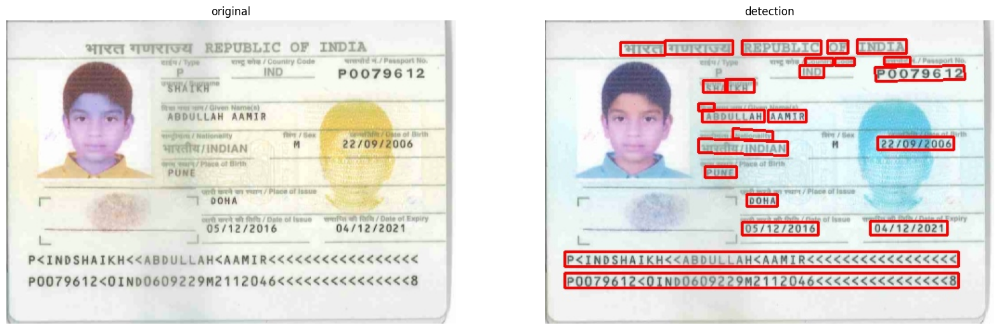

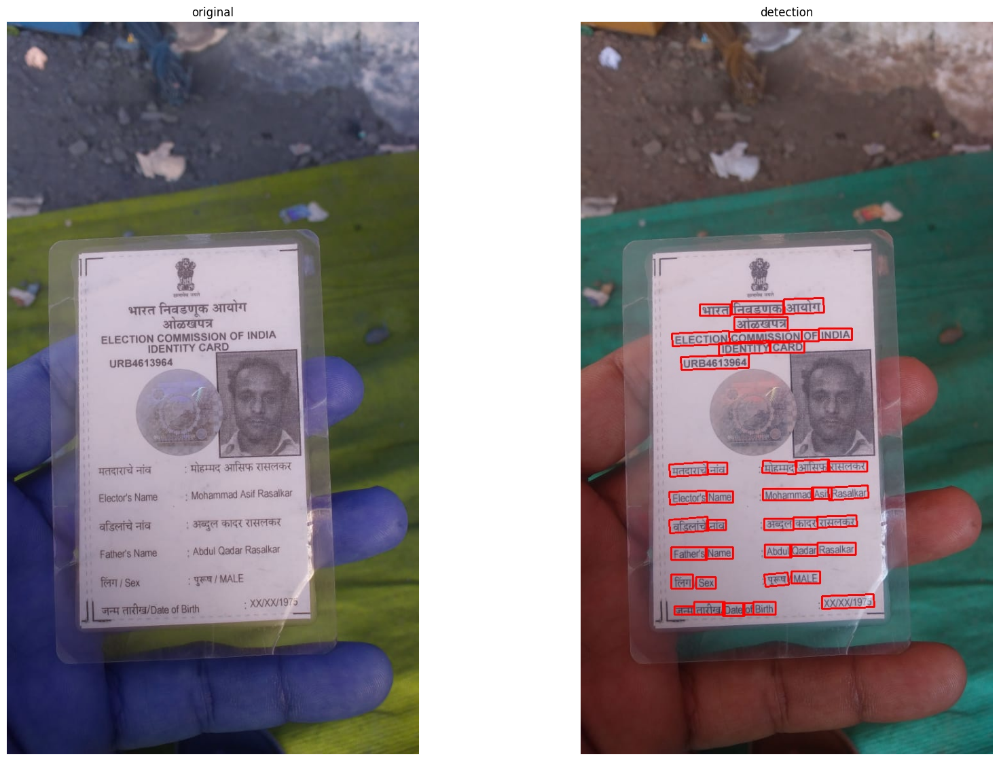

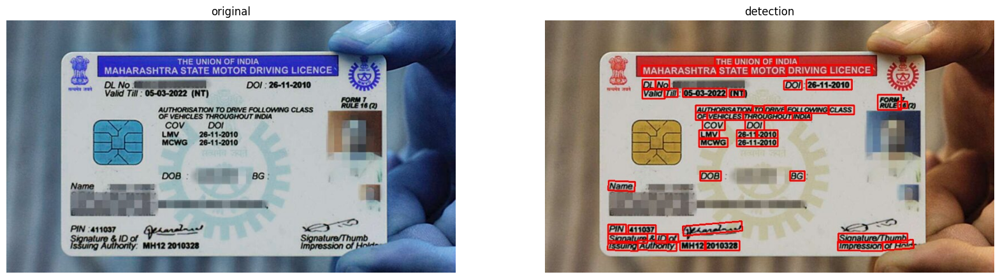

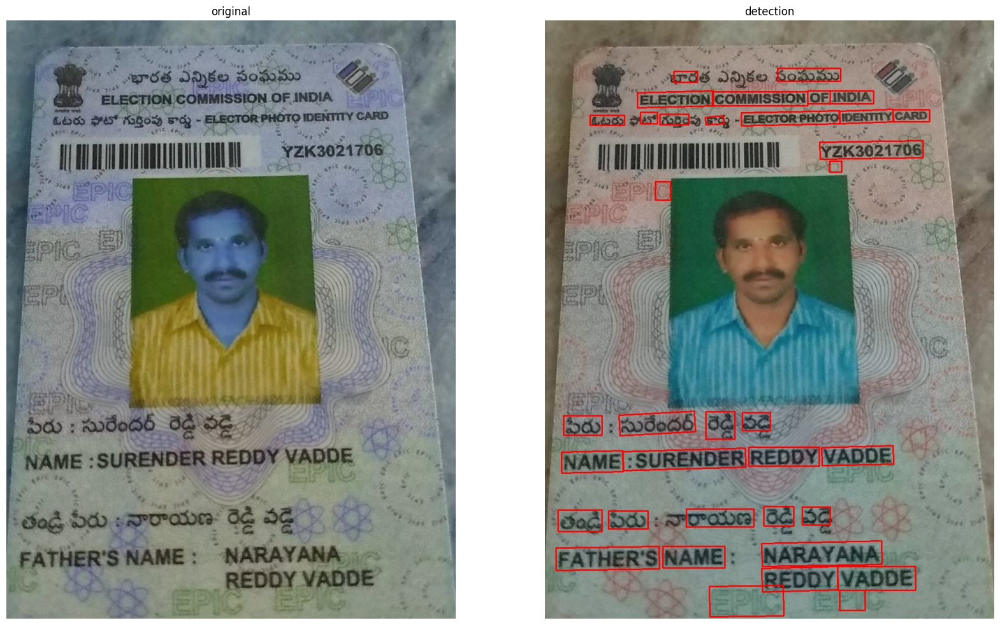

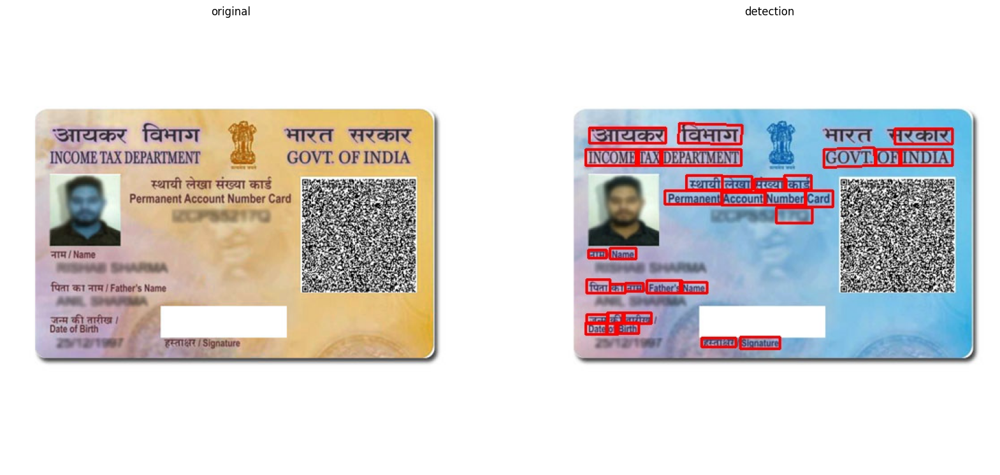

...

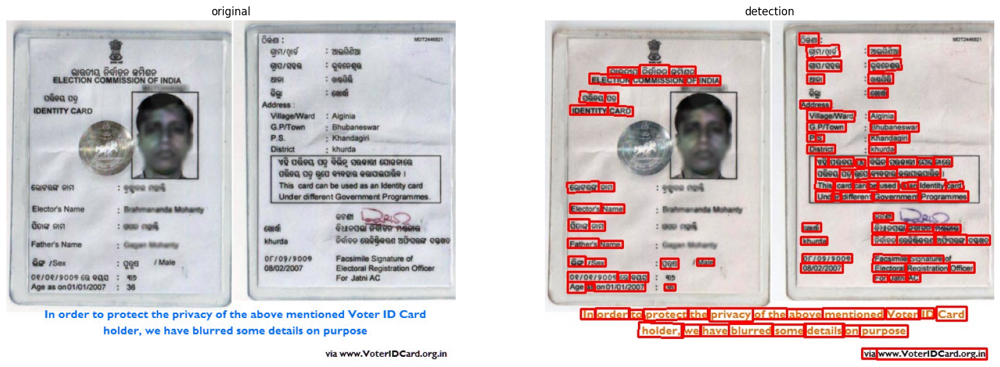

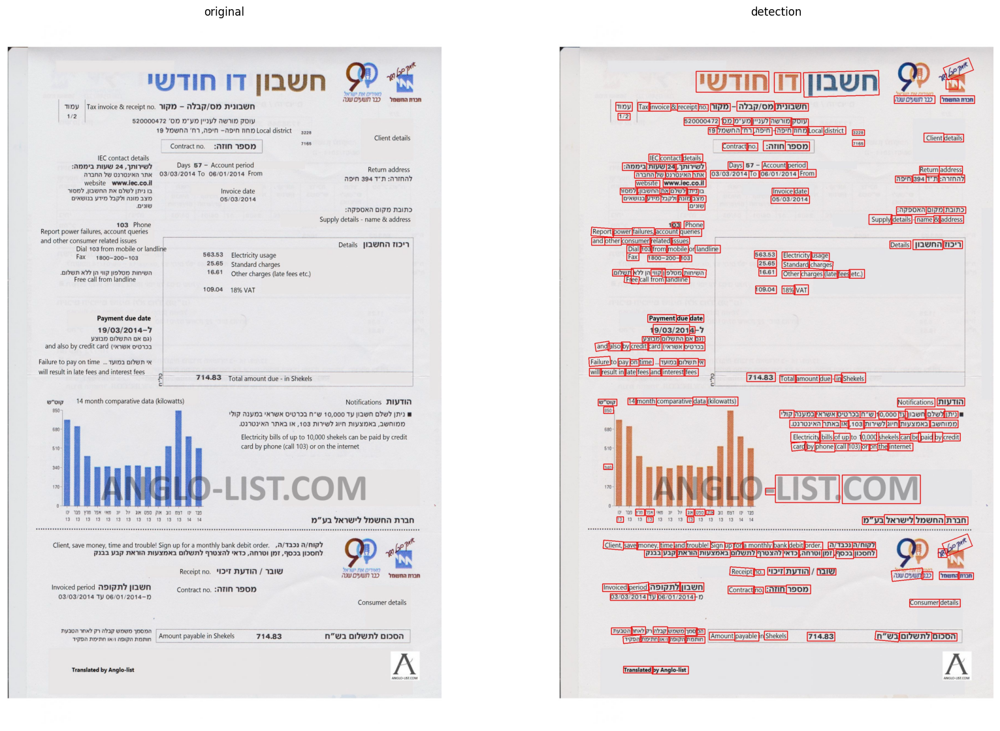

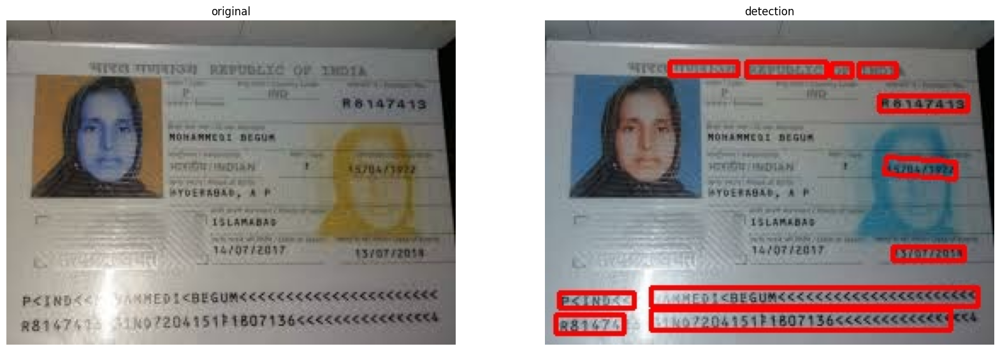

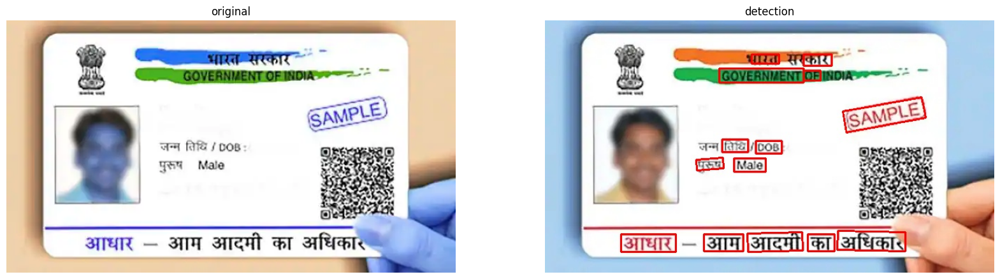

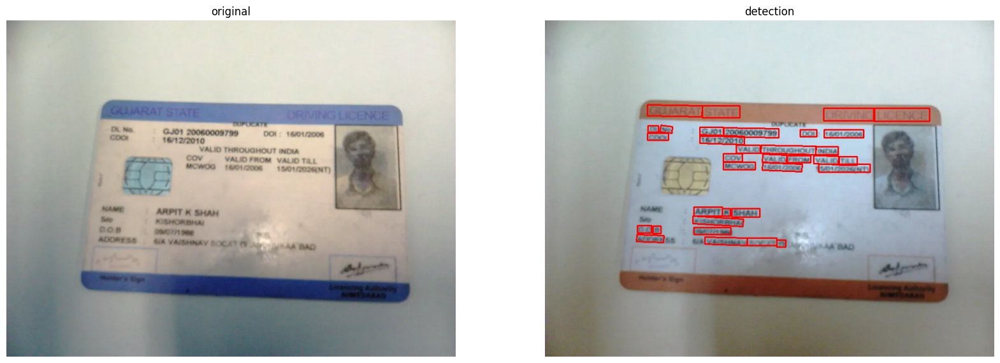

In [ ]:
import cv2
import os
from matplotlib import pyplot as plt
import matplotlib.image as mpimg


# create figure


for img in os.listdir("/content/tesing"):
    fig = plt.figure(figsize=(20, 14))
    rows = 1
    columns = 2
    Image1 = cv2.imread(f'/content/tesing/{img}')
    Image2 = mpimg.imread(f'/content/result/res_{img}'.replace('jpeg','jpg').replace('png', 'jpg'))
    fig.add_subplot(rows, columns, 1)
    plt.imshow(Image1)
    plt.axis('off')
    plt.title("original")
    fig.add_subplot(rows, columns, 2)
    plt.imshow(Image2)
    plt.axis('off')
    plt.title("detection")
    plt.show()